<a href="https://colab.research.google.com/github/FelipeH22/siamese-neural-network/blob/main/siamese_neural_network.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Siamese Neural Network Triplet Loss


In [ ]:
%%capture
!pip install tensorflow -U

In [ ]:
import os
import math
import copy
import json
import numpy as np
import pandas as pd
import tensorflow as tf
import matplotlib.pyplot as plt

In [ ]:
print(tf.__version__)  # In order to use keras 3

2.16.1


## Dataset downloading

The dataset is downloaded directly from the kaggle webpage using the `kaggle datasets download username/dataset_name` instruction in the terminal. After the dataset has been correctly downloaded, it is unzipped and stored in a folder.

In [ ]:
!kaggle datasets download johnarevalo/raw-mmimdb

Dataset URL: https://www.kaggle.com/datasets/johnarevalo/raw-mmimdb
License(s): unknown
100% 16.2G/16.2G [02:02<00:00, 156MB/s]
100% 16.2G/16.2G [02:02<00:00, 141MB/s]


In [ ]:
%%capture
!unzip raw-mmimdb.zip -d ./

In [ ]:
!rm ./raw-mmimdb.zip

In [ ]:
img_dir = "./mmimdb/dataset/"  # Path where the dataset is stored

## 1. Triplets building process and distances

In order to build the triplets, the process described in the assignment instructions are followed. These steps are:
1.   Select a random batch B of $b$ images from the dataset.
2.   Select a random image from B as the anchor ($x_i$).
3.   Sort the remaining images ($b-1$) according to the Jaccard index between the anchor and each of the images.
4.   Choose the first image (that with the smallest distance) as the positive sample ($x^+$).
5.   Choose the last image (biggest distance) as the negative sample ($x^-$).
6.   Store the triplet ($x_i$, $x^+$, $x^-$) and the Jaccard distances ($1-J(y_i, y^+)$ and $1-J(y_i, y^-)$).
7.   Repeat steps 2-6, $n$ times.
8.   Repeat steps 1-7, $m$ times.

Where $$J(y_i, y_j) = \frac{|y_i \cap y_j|}{|y_i \cup y_j|}$$ and $y_i$ and $y_j$ the labels (genres) for the corresponding image $x_i$, $x_j$.

Since the main objective is building a dataset consisting of groups of three images, some measures are taken in order to save computational resources. At this point, the images are not stored or read. Instead, the whole process is made with the file name and thus, the triplets contain only the filename of the images.

In [ ]:
def jaccard_distance(img1: str, img2: str):
  # Compute Jaccard distance between two images
  def extract_genres(image):
    # Extract genres from the json file of an image
    json_file_img1 = os.path.join(img_dir, f"{os.path.splitext(image)[0]}.json")
    if os.path.exists(json_file_img1):
      with open(json_file_img1, 'r') as json_file:
        data = json.load(json_file)
        return set(map(lambda x: x.lower(), data.get("genres", [])))
  genres_1 = extract_genres(img1)
  genres_2 = extract_genres(img2)
  if genres_1 is None or genres_2 is None: return 0
  return len(genres_1.intersection(genres_2))/len(genres_1.union(genres_2))

In [ ]:
def build_dataset(m=140, n=150, b=250):
  triplets = list()  # Triplets in the form (anchor, positive, negative)
  distances = list()  # Distances (1-J(x_i, x+), 1-J(x_i, x-))
  image_dir = "./mmimdb/dataset/"
  images_paths = [image_file for image_file in os.listdir(image_dir) if image_file.endswith('.jpeg')]
  for j in range(m):
    images = [images_paths[int(i)] for i in np.floor(np.random.uniform(0, len(images_paths), b))]
    for i in range(n):
      anchor_chosen = np.floor(np.random.uniform(0, len(images), 1)[0])  # Randomly chosen anchor
      x_i = images[int(anchor_chosen)]
      # Sort by jaccard
      images.sort(key=lambda x: jaccard_distance(x_i, x), reverse=True)  # Sort the images
      # Since the anchor is not removed from the list, check if the most similar is the anchor itself.
      # If true, select the next most similar.
      positive = images[0] if images[0]!=x_i else images[1]
      triplets.append((x_i, positive, images[-1]))
      distances.append((1-jaccard_distance(x_i, positive), 1-jaccard_distance(x_i, images[-1])))
  return triplets, distances

In [ ]:
# This cell takes about 2-3 hours to run, if possible, use the csv already exported.
triplets, distances = build_dataset()

In [ ]:
# Save triplets, distances, etc. in a pandas dataframe just in case.
df = pd.DataFrame.from_dict({
    "triplet": triplets,
    "distance_pos": [elements[0] for elements in distances],
    "distance_neg": [elements[1] for elements in distances]
})
df.to_csv("dataframe.csv", index=False)
del triplets
del distances

In [ ]:
# Defining epsilon so the distances are non-zero values
epsilon = 1e-10

In [ ]:
# Get dataset from the csv exported and add epsilon to the distances.
from ast import literal_eval
df = pd.read_csv("./dataframe.csv")
df["triplet"] = [literal_eval(x) for x in df["triplet"]]
df[["distance_pos", "distance_neg"]] = df[["distance_pos",
                                           "distance_neg"]].apply(lambda x: x+epsilon)

In [ ]:
# Select only the triplets that have a positive similarity greater than 0.5
df = df.loc[df["distance_pos"]<0.1] # Distances were stored as 1-J
df = df.drop_duplicates(subset=["triplet"])
df = df.sample(len(df), ignore_index=True)
df

,triplet,distance_pos,distance_neg
0,"(2077747.jpeg, 2077747.jpeg, 0050407.jpeg)",1.000000e-10,1.0
1,"(0029146.jpeg, 1285016.jpeg, 1650416.jpeg)",1.000000e-10,1.0
2,"(0087688.jpeg, 0220627.jpeg, 2066922.jpeg)",1.000000e-10,1.0
3,"(0088128.jpeg, 0051196.jpeg, 0252612.jpeg)",1.000000e-10,1.0
4,"(1323973.jpeg, 3032028.jpeg, 1160018.jpeg)",1.000000e-10,1.0
...,...,...,...
11341,"(0191019.jpeg, 0787485.jpeg, 0000005.jpeg)",1.000000e-10,1.0
11342,"(0284262.jpeg, 2954776.jpeg, 0038321.jpeg)",1.000000e-10,1.0
11343,"(0439771.jpeg, 0985025.jpeg, 0030817.jpeg)",1.000000e-10,1.0
11344,"(0212830.jpeg, 0092850.jpeg, 0260948.jpeg)",1.000000e-10,1.0


## Examples of triplets

In order to get a visual idea of the triplets, some examples are shown below. The first column corresponds to the anchor, the second one to the positive sample and the negative one is shown in the last column. The title of each image shows the genres found in the JSON file

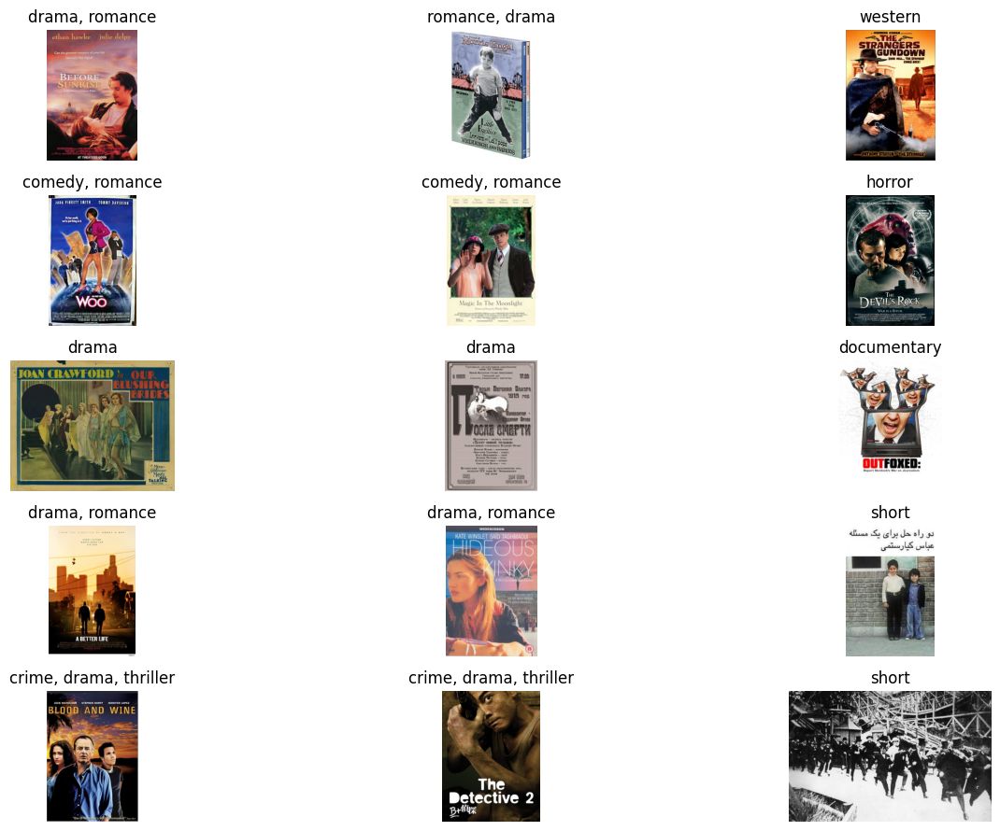

In [ ]:
fig, axes = plt.subplots(5, 3, figsize=(15, 9))
axes = axes.flatten()
choices = np.floor(np.random.uniform(0, len(df["triplet"]), 5)).astype(np.int64)
for i in range(5):
  for j in range(3):
    axes[i*3+j].imshow(plt.imread(img_dir+df["triplet"][choices[i]][j]))
    with open(img_dir+df["triplet"][choices[i]][j].split(".jp")[0]+".json", 'r') as json_file:
      data = json.load(json_file)
      genres = list(map(lambda x: x.lower(), data.get("genres", [])))
    axes[i*3+j].set_title(", ".join(genres))
    axes[i*3+j].axis('off')
plt.tight_layout()
plt.show()

## Data pipeline for the model

A tensorflow data or input pipeline allows building ingestion and transformation workflows from different kind of sources such as directories or already built structures like numpy arrays without impacting the computational resources much.

In this case, as explained before, the data at this point is not stored as images but as a string with the name of the file. So, in order to get the data in the format needed, some transformation steps are added to the pipeline.

First, a preprocessing function is defined in order to receive the triplet with the file names and read the images to after apply some preprocessing steps defined in the sequential model below. The image is resized into 200x200, the pixel values are scaled to $[0, 1]$ values and then a zoom is applied randomly. The function returns then the triplet with the images in the expected size.

In [ ]:
prepro = tf.keras.Sequential([
  tf.keras.layers.Resizing(200, 200),
])
def preprocess_image(images):
  return (prepro(tf.image.decode_jpeg(tf.io.read_file(img_dir+images[0]), channels=3)),
  prepro(tf.image.decode_jpeg(tf.io.read_file(img_dir+images[1]), channels=3)),
  prepro(tf.image.decode_jpeg(tf.io.read_file(img_dir+images[2]), channels=3)))

The last step of the pipeline is the dataset split, corresponding to training (60%), validation (20%) and test (20%).

In [ ]:
dataset = tf.data.Dataset.from_tensor_slices((df["triplet"].to_list(),
                                              (df["distance_pos"].to_list(),
                                              df["distance_neg"].to_list())))
dataset = dataset.shuffle(buffer_size=1024)
train_dataset = dataset.take(math.floor(len(df)*.6)).map(lambda x, y: (preprocess_image(x), y)).batch(32, drop_remainder=True)
validation_dataset = dataset.skip(math.floor(len(df)*.6)).take(math.floor(len(df)*.2)).map(lambda x, y: (preprocess_image(x), y)).batch(32, drop_remainder=True)
test_dataset = dataset.skip(math.floor(len(df)*.8))
train_dataset = train_dataset.prefetch(tf.data.AUTOTUNE)
validation_dataset = validation_dataset.prefetch(tf.data.AUTOTUNE)

## 2. Model definition

The model built is described in the image below


<p align="center">
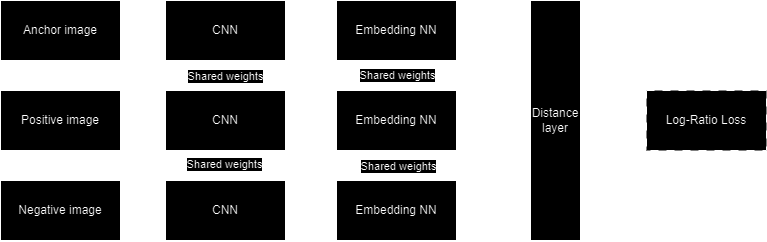
</p>

where the CNN correspond to a ResNet50 network with freezed layers except for the last few ones that were enabled to train in order to update their weights for this specific problem. The embedding part of the model, are two dense layers with relu activation with an additional dropout layer at the end of each one in order to avoid overfitting. The final layer of the embedding corresponds to a dense layer with 256 units.
The last part of the model, correspond to a distance layer that as its names indicates, finds the distance between the embedding of the three images using the squared euclidean distance, and, the output is then sent to a Log-Ratio loss.

In [ ]:
# Custom tensorflow layer for distance between embeddings
class DistanceLayer(tf.keras.layers.Layer):
  def __init__(self, **kwargs):
    super().__init__(**kwargs)

  def call(self, anchor, positive, negative):
    positive_distance = tf.keras.ops.sum(tf.square(anchor - positive), -1)  # Squared euclidean distances anchor->positive
    negative_distance = tf.keras.ops.sum(tf.square(anchor - negative), -1)  # Squared euclidean distances anchor->negative
    return (positive_distance, negative_distance)

In [ ]:
def model_definition(embedding_size: int):
  # Downloading resnet without the last layers
  resnet = tf.keras.applications.ResNet50(weights="imagenet",
                                          input_shape=(200, 200) + (3,),
                                          include_top=False)
  flatten = tf.keras.layers.Flatten()(resnet.output)

  # Regularization is applied because for previous experiments the model was overfitting
  dense0 = tf.keras.layers.Dense(embedding_size,
                                activation="relu",
                                kernel_regularizer=tf.keras.regularizers.L2(),
                                bias_regularizer=tf.keras.regularizers.L2())(flatten)
  dense0 = tf.keras.layers.BatchNormalization()(dense0)

  dense1 = tf.keras.layers.Dense(int(embedding_size/2),
                                activation="relu",
                                kernel_regularizer=tf.keras.regularizers.L2(),
                                bias_regularizer=tf.keras.regularizers.L2())(dense0)
  dense1 = tf.keras.layers.BatchNormalization()(dense1)

  output = tf.keras.layers.Dense(embedding_size)(dense1)

  embedding = tf.keras.Model(resnet.input, output, name="Embedding")

  # Making the last few layers of the pretrained ResNet50 model trainable
  trainable = False
  for layer in resnet.layers:
    if layer.name == "conv5_block1_out":
        trainable = True
    layer.trainable = trainable

  # The model receives three images as inputs
  anchor_input = tf.keras.layers.Input(name="anchor", shape=(200, 200) + (3,))
  positive_input = tf.keras.layers.Input(name="positive", shape=(200, 200) + (3,))
  negative_input = tf.keras.layers.Input(name="negative", shape=(200, 200) + (3,))

  # Distances between the embeddings of the three images
  distances = DistanceLayer()(
      embedding(tf.keras.applications.resnet.preprocess_input(anchor_input)),
      embedding(tf.keras.applications.resnet.preprocess_input(positive_input)),
      embedding(tf.keras.applications.resnet.preprocess_input(negative_input)),
  )

  siamese_network = tf.keras.Model(
      inputs=[anchor_input, positive_input, negative_input], outputs=distances
  )

  return siamese_network, embedding

In [ ]:
@tf.keras.utils.register_keras_serializable('model_siamese')
class SiameseModel(tf.keras.Model):
  def __init__(self, siamese_network):
    super(SiameseModel, self).__init__()
    self.siamese_network = siamese_network
    self.loss_tracker = tf.keras.metrics.Mean(name="loss")

  def call(self, inputs):
    return self.siamese_network(inputs)

  def train_step(self, data):
    with tf.GradientTape() as tape:
      loss = self._compute_loss(data)
    gradients = tape.gradient(loss, self.siamese_network.trainable_weights)
    self.optimizer.apply_gradients(zip(gradients, self.siamese_network.trainable_weights))
    self.loss_tracker.update_state(loss)
    return {"loss": self.loss_tracker.result()}

  def test_step(self, data):
    loss = self._compute_loss(data)
    self.loss_tracker.update_state(loss)
    return {"loss": self.loss_tracker.result()}

  # Log-Ratio Loss
  def _compute_loss(self, data):
    ap_distance, an_distance = self.siamese_network((data[0][0], data[0][1], data[0][2]))
    return tf.square(tf.keras.ops.subtract(tf.keras.ops.log10(tf.keras.ops.divide((ap_distance+epsilon),(an_distance+epsilon))),
                                            tf.keras.ops.log10(tf.keras.ops.divide(data[1][0], data[1][1]))))
  @property
  def metrics(self):
    return [self.loss_tracker]

In [ ]:
def get_trained_model(embedding_size: int):
  """
  This function is created in order to train the a model with the embedding size
  received as an argument for 20 epochs monitoring the validation loss and
  stopping when there has not been an improvement for 4 epochs.
  The best model is saved in a file named model_embeddingsize. The trained model
  and the corresponding embedding layer are returned.
  """
  siamese_network, embedding = model_definition(embedding_size)
  siamese_model = SiameseModel(siamese_network)
  siamese_model.compile(optimizer=tf.keras.optimizers.Adam(0.0001))
  siamese_model.predict(validation_dataset.take(1), verbose=2)  # Model initialization (saving)
  siamese_model.save(f"./model_{embedding_size}.keras")
  print(f"Training model with embedding of size {embedding_size}: \n")
  siamese_model.fit(train_dataset, epochs=20, validation_data=validation_dataset,
                    callbacks=[tf.keras.callbacks.ModelCheckpoint(f"./model_{embedding_size}.keras",
                                                                  monitor="val_loss",
                                                                  save_best_only=True),
                              tf.keras.callbacks.EarlyStopping(monitor="val_loss",
                                                                patience=4)])
  return siamese_model, embedding

Now, since one of the main goals of the implementation is comparing the model performance for multiple embeddings, the following cells contain the code for the training and posterior performance monitoring functions definitions, the goal is retrieving predictions for each embedding size and retrieving the 10 nearest neighbors for some of the images in the test dataset using their corresponding embedding. In order to do that and measure all the model with the same examples the code and examples fot the three models are defined below

Examples and functions in order to plot the triplets with their predicted distance, another plot for the neihgbors of some examples:

In [ ]:
validation_example = next(validation_dataset.take(1).as_numpy_iterator())

In [ ]:
def plot_predictions(model, validation_example, embedding_size):
  """
  Plots the above example from the validations dataset with the distances predicted
  from the model sent as an argument.
  """
  fig, axes = plt.subplots(5, 3, figsize=(15, 9))
  plt.suptitle(f"Predictions, model with embedding {embedding_size} \n")
  axes = axes.flatten()
  example = validation_example
  ind = np.array(range(5))
  j = 0
  for i in ind:
    result_pos, result_neg = model((example[0][0][i].reshape(1, 200, 200, 3),
                                        example[0][1][i].reshape(1, 200, 200, 3),
                                        example[0][2][i].reshape(1, 200, 200, 3)))
    axes[j*3].imshow(example[0][0][i]/255)
    axes[j*3+1].imshow(example[0][1][i]/255)
    axes[j*3+1].set_title(f"predicted: {result_pos[0]}. real: {example[1][0][i]}")
    axes[j*3+2].imshow(example[0][2][i]/255)
    axes[j*3+2].set_title(f"predicted: {result_neg[0]}. real: {example[1][1][i]}")
    j+=1
  plt.tight_layout()
  plt.show()

In [ ]:
prepro = tf.keras.Sequential([
  tf.keras.layers.Resizing(200, 200)
])
def get_images(images, distances):
  """
  Extracts the images from the test dataset.
  Since Jaccard distances are not important anymore, the second element of the tuple
  will be replaced with the file name of the original images in order to extract
  the original image and the json file. The output of this function is:
  ((anchor_image, pos_image, neg_image), ('img001.jpg', 'img003.jpg', 'imgYYY.jpg')
  """
  def get_image(image):
    return tf.keras.applications.resnet.preprocess_input(
              prepro(tf.image.decode_jpeg(tf.io.read_file(img_dir+image), channels=3))
              )
  return ((get_image(images[0]), get_image(images[1]), get_image(images[2])),
          (images))

In [ ]:
def get_examples():
  """
  Extracts the 1000 examples from the test dataset
  """
  movies = list()
  test = test_dataset.shuffle(256).take(1000)
  test_c = test.map(lambda x, y: get_images(x, y))
  ite = test_c.take(500).as_numpy_iterator()
  for _ in range(500):
    row = next(ite)
    for i in range(3):
      movie = {
          "image": row[0][i],
          "file_name": row[1][i]
      }
      movies.append(movie)
  movies = np.array(movies)
  # Choosing 10 random movies and removing the from the movies list
  random_ind = np.floor(np.random.uniform(0, len(movies), 10)).astype(np.int32)
  selected_movies = movies[random_ind]
  movies_ = [mov for mov in movies if mov["file_name"] not in [se["file_name"] for se in selected_movies]]
  movies = pd.DataFrame(movies_).drop_duplicates(subset=["file_name"], ignore_index=True)
  selected_movies = pd.DataFrame(list(selected_movies))
  return movies, selected_movies  # Tuple containing the 1000*3 movies and the 5 selected movies for whom the neighbors will be computed.

Since the following cell computes the distance between embeddings of two images in order to build the ten nearest neighbors using the euclidean distance, then the nCDG computation can be done here too. The equation used is described as follows.
$$
nDCG_K(q) = \frac{1}{Z_k}\displaystyle\sum_{i=1}^{K} \frac{2^{r_i}}{log_2(i+1)}
$$
where $r_i = -log_2(||y_q - y_i||_2+1)$.

For this specific example, the normalization factor $Z_k$ will correspond to the maximum value of $\frac{2^{r_i}}{log_2(i+1)}$ between all the images ($i$). Also, instead of computing the importance factor $r_i$ as described above, this factor will be computed as $r_i = -log_2(J(y_q, y_i)+1)$. Where $J(y_i, y_j)$ corresponds to the Jaccard distance (1 - Jaccard Similarity).

In [ ]:
def plot_neighbors(k, embedding_, movies_, selected_movies_, embedding_size, plot=True):
  """
  Gets the k nearest neighbors from the examples chosen from the test dataset (movies_)
  for the randomly selected movies (selected_movies_) using the embedding (embedding_) of a model.
  The nDCG is computed here for the neighbors obtained.
  If the plot flag is set to True, the selected movies and their corresponding neighbors are shown in a plot
  """
  ndcg = list()

  def get_embedding(image, embedding):
    # Get the embedding representation of an image (uses the embedding model passed as an argument)
    return embedding(image[np.newaxis, ...]).numpy()[0]

  movies_["image"] = movies_["image"].apply(lambda x: get_embedding(x, embedding_))
  selected_movies_["image"] = selected_movies_["image"].apply(lambda x: get_embedding(x, embedding_))

  if plot:
    fig, axes = plt.subplots(nrows=5, ncols=11, figsize=(35, 35))
    plt.suptitle(f"{k} nearest neighbors, model with embedding {embedding_size}")


  for i in range(5):
    if "distance" in movies_.columns: del movies_["distance"]
    movies_["distance"] = [np.linalg.norm(movies_.loc[k]["image"]-selected_movies_.loc[i]["image"]) for k in range(len(movies))]
    tnn = movies_.sort_values(by="distance", ignore_index=True, ascending=True)[:k]
    tnn = tnn.reset_index()
    tnn["ndcg"] = [(2**(-math.log2(1-jaccard_distance(selected_movies_.loc[i]["file_name"].decode(),
                                                    tnn.loc[k]["file_name"].decode())+epsilon+1)))/(math.log2(k+1+1)) for k in range(len(tnn))]
    ndcg.append((1/np.max(tnn["ndcg"].to_numpy()))*np.sum(tnn["ndcg"].to_numpy()))
    if plot:
      axes[i, 0].imshow(plt.imread(img_dir+str(selected_movies_.loc[i]["file_name"].decode())))
      with open(img_dir+str(selected_movies_.loc[i]["file_name"].decode()).split(".jp")[0]+".json", 'r') as json_file:
        data = json.load(json_file)
        genres = list(map(lambda x: x.lower(), data.get("genres", [])))
      axes[i, 0].set_title(", ".join(genres))
      for j in range(len(tnn)):
        axes[i, j+1].imshow(plt.imread(img_dir+str(tnn.loc[j]["file_name"].decode())))
        with open(img_dir+str(tnn.loc[j]["file_name"].decode()).split(".jp")[0]+".json", 'r') as json_file:
          data = json.load(json_file)
          genres = list(map(lambda x: x.lower(), data.get("genres", [])))
        axes[i, j+1].set_title(", ".join(genres))
  if plot:
    for ax in axes.flatten():
      ax.axis('off')
    plt.tight_layout()
    plt.show()
    del movies_
    del selected_movies_
  return ndcg

In [ ]:
movies, selected_movies = get_examples()  # Same movies for the three models

### Model with an embedding size of 256

The following three cells are repeated for each model (256, 128, 64 and 32 embedding size), corresponding to:
 1. Training of the model
 2. Predictions for some triplets from the validation dataset
 3. Showing the 10 nearest neighbors for some of the movies from the test dataset - Storing the nDCG for 10, 20, 40, 60 and 80 retrievals.

In [ ]:
model_256, embedding_256 = get_trained_model(256)

1/1 - 11s - 11s/step
Training model with embedding of size 256: 

Epoch 1/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 147s 551ms/step - loss: 70.2252 - val_loss: 27.5446
Epoch 2/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 514ms/step - loss: 21.4266 - val_loss: 26.3357
Epoch 3/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 521ms/step - loss: 18.9360 - val_loss: 15.6718
Epoch 4/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 516ms/step - loss: 11.6278 - val_loss: 13.0093
Epoch 5/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 517ms/step - loss: 8.9169 - val_loss: 10.3322
Epoch 6/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 515ms/step - loss: 7.0634 - val_loss: 8.6375
Epoch 7/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 518ms/step - loss: 5.9945 - val_loss: 8.4800
Epoch 8/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 108s 510ms/step - loss: 5.6768 - val_loss: 8.8153
Epoch 9/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 106s 498ms/step - loss: 5.3983 - val_loss: 9.1013
Epoch 10/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 515ms/step - loss: 5.4893 - val_loss: 7.7890
Epoch 11/20
212/212 ━━━━

Prediction of the distance between the anchor and the positive and negative example from the validation dataset

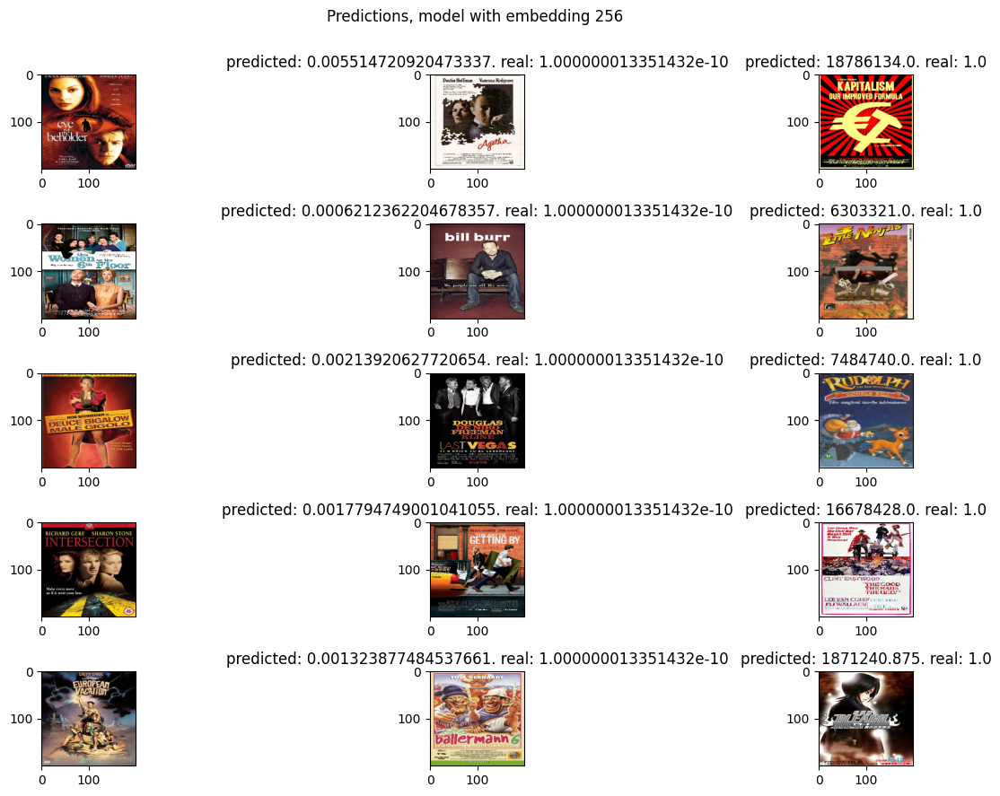

In [ ]:
plot_predictions(model_256, validation_example, 256)

For the examples retrieved from the validation dataset it can be seen that the distances get quite similar to the real ones computed with the Jaccard distance, the positive example gets a value close to zero and for the negative example the distances grows to different values that are over a million but that somehow behaves as expected in order to put the negative sample very distant from the anchor.

10 Nearest neighbors for the selected movies using 256 embedding size

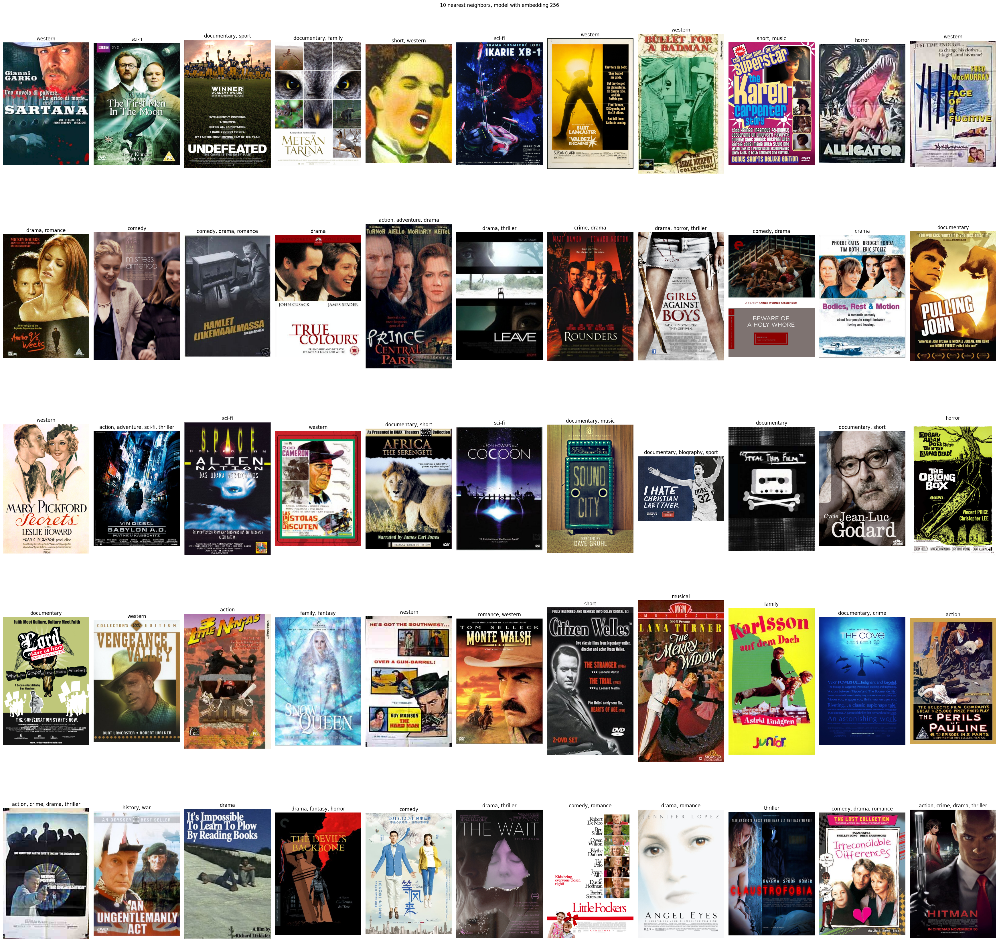

In [ ]:
ndcg_256 = [
    np.mean(plot_neighbors(10, embedding_256, copy.deepcopy(movies), copy.deepcopy(selected_movies), 256)),
    np.mean(plot_neighbors(20, embedding_256, copy.deepcopy(movies), copy.deepcopy(selected_movies), 256, False)),
    np.mean(plot_neighbors(40, embedding_256, copy.deepcopy(movies), copy.deepcopy(selected_movies), 256, False)),
    np.mean(plot_neighbors(60, embedding_256, copy.deepcopy(movies), copy.deepcopy(selected_movies), 256, False)),
    np.mean(plot_neighbors(80, embedding_256, copy.deepcopy(movies), copy.deepcopy(selected_movies), 256, False)),
]

In this last figure, the first column correspond to 5 randomly chosen posters from the test dataset and each row holds the 10 nearest neighbors (using the euclidean distance) for the movie.
From this image, some insights are evident. Even though there are some mistaken posters closer to the reference images, there are some other ones with very similar genres in the same row. Specifically, for the drama movies, most of the neighbors are similar to their reference image according to their real genres, a similar behaviour but with less precision (not the formal precision metric but the amount of neighbors that share the genres with their reference poster) applies to the western movies

### Model with an embedding size of 128

In [ ]:
model_128, embedding_128 = get_trained_model(128)

1/1 - 9s - 9s/step
Training model with embedding of size 128: 

Epoch 1/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 154s 593ms/step - loss: 73.0977 - val_loss: 32.0532
Epoch 2/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 113s 533ms/step - loss: 24.8208 - val_loss: 27.1305
Epoch 3/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 517ms/step - loss: 18.4475 - val_loss: 17.3581
Epoch 4/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 516ms/step - loss: 17.4501 - val_loss: 17.1518
Epoch 5/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 120s 566ms/step - loss: 14.4480 - val_loss: 14.2739
Epoch 6/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 514ms/step - loss: 12.3902 - val_loss: 12.3304
Epoch 7/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 106s 498ms/step - loss: 9.5090 - val_loss: 12.4558
Epoch 8/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 108s 512ms/step - loss: 9.0998 - val_loss: 9.9608
Epoch 9/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 518ms/step - loss: 8.3235 - val_loss: 9.4009
Epoch 10/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 108s 508ms/step - loss: 7.4150 - val_loss: 9.8151
Epoch 11/20
212/212 ━━

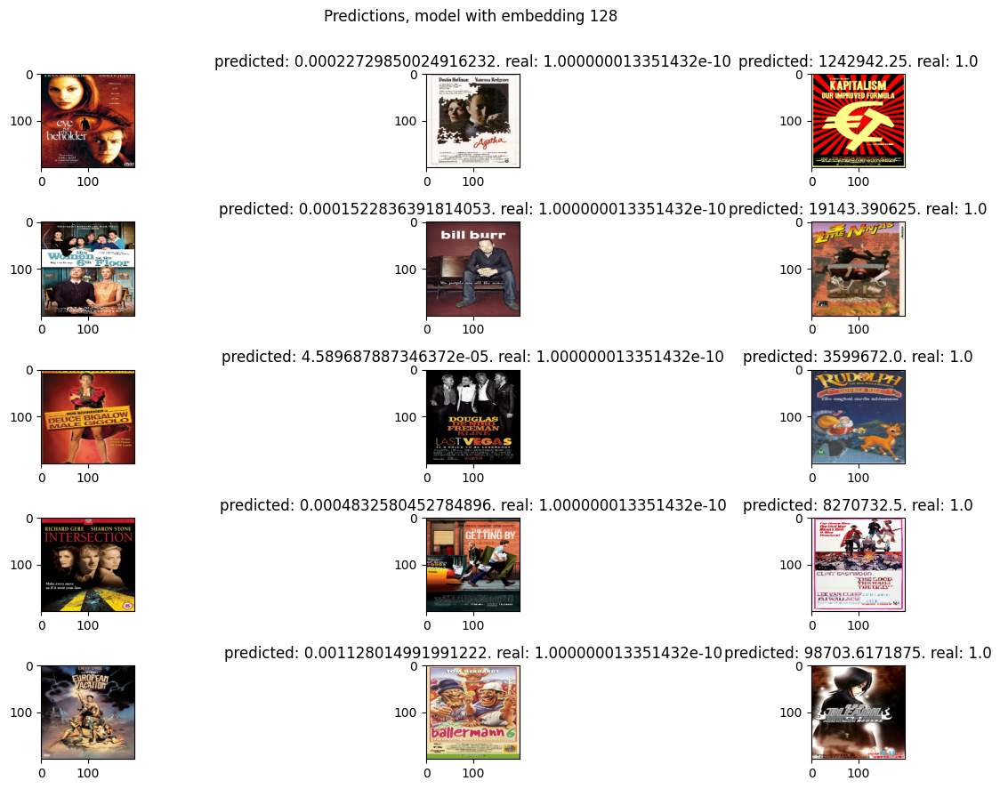

In [ ]:
plot_predictions(model_128, validation_example, 128)

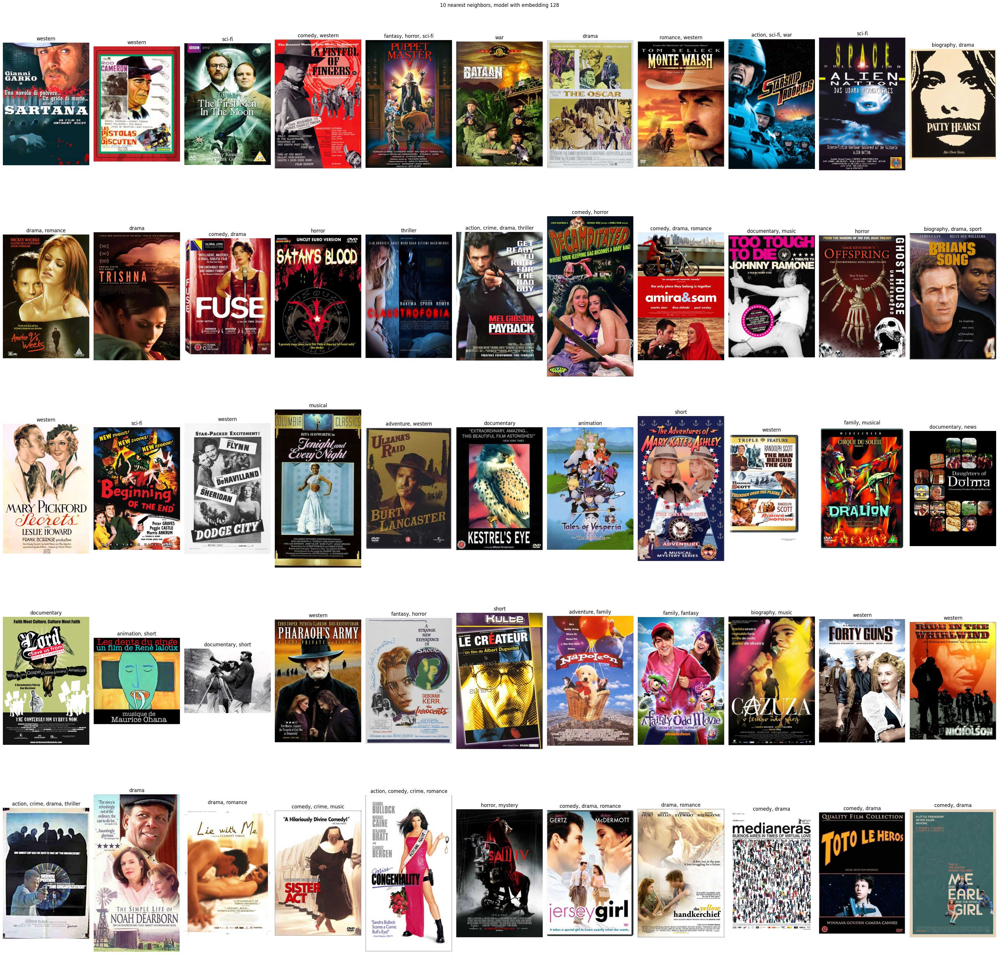

In [ ]:
ndcg_128 = [
    np.mean(plot_neighbors(10, embedding_128, copy.deepcopy(movies), copy.deepcopy(selected_movies), 128)),
    np.mean(plot_neighbors(20, embedding_128, copy.deepcopy(movies), copy.deepcopy(selected_movies), 128, False)),
    np.mean(plot_neighbors(40, embedding_128, copy.deepcopy(movies), copy.deepcopy(selected_movies), 128, False)),
    np.mean(plot_neighbors(60, embedding_128, copy.deepcopy(movies), copy.deepcopy(selected_movies), 128, False)),
    np.mean(plot_neighbors(80, embedding_128, copy.deepcopy(movies), copy.deepcopy(selected_movies), 128, False)),
]

In both figures shown for this model, the behaviour is somehow similar to the last one (256-D) so no further comments are necessary here more than saying that the predictions got smaller for the positive examples and for some negative examples too.

### Model with an embedding size of 64

In [ ]:
model_64, embedding_64 = get_trained_model(64)

1/1 - 9s - 9s/step
Training model with embedding of size 64: 

Epoch 1/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 148s 566ms/step - loss: 74.2615 - val_loss: 34.2310
Epoch 2/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 526ms/step - loss: 31.1043 - val_loss: 24.4010
Epoch 3/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 109s 515ms/step - loss: 23.5107 - val_loss: 22.5435
Epoch 4/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 518ms/step - loss: 21.0001 - val_loss: 19.5504
Epoch 5/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 122s 576ms/step - loss: 16.7115 - val_loss: 19.9651
Epoch 6/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 517ms/step - loss: 16.8398 - val_loss: 17.6155
Epoch 7/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 520ms/step - loss: 15.4063 - val_loss: 16.0903
Epoch 8/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 108s 510ms/step - loss: 14.3692 - val_loss: 17.8988
Epoch 9/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 110s 520ms/step - loss: 14.9341 - val_loss: 14.8919
Epoch 10/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 111s 522ms/step - loss: 10.9838 - val_loss: 14.6087
Epoch 11/20
212/

In [ ]:
# Cell output hidden in order to reduce notebook size
plot_predictions(model_64, validation_example, 64)

In [ ]:
# Cell output hidden in order to reduce notebook size
ndcg_64 = [
    np.mean(plot_neighbors(10, embedding_64, copy.deepcopy(movies), copy.deepcopy(selected_movies), 64)),
    np.mean(plot_neighbors(20, embedding_64, copy.deepcopy(movies), copy.deepcopy(selected_movies), 64, False)),
    np.mean(plot_neighbors(40, embedding_64, copy.deepcopy(movies), copy.deepcopy(selected_movies), 64, False)),
    np.mean(plot_neighbors(60, embedding_64, copy.deepcopy(movies), copy.deepcopy(selected_movies), 64, False)),
    np.mean(plot_neighbors(80, embedding_64, copy.deepcopy(movies), copy.deepcopy(selected_movies), 64, False)),
]

This specific model according to the distance predictions shows a worse behaviour because some positive examples' distances got higher than for the previous distances obtained with the other models. Also, some couples (neighbors, reference poster) are worse than for the previous models.

### Model with an embedding size of 32

In [ ]:
model_32, embedding_32 = get_trained_model(32)

1/1 - 9s - 9s/step
Training model with embedding of size 32: 

Epoch 1/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 148s 561ms/step - loss: 83.2949 - val_loss: 44.1967
Epoch 2/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 113s 530ms/step - loss: 39.1735 - val_loss: 29.1847
Epoch 3/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 525ms/step - loss: 24.4013 - val_loss: 21.8173
Epoch 4/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 113s 532ms/step - loss: 20.0669 - val_loss: 19.0109
Epoch 5/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 529ms/step - loss: 17.2655 - val_loss: 16.3402
Epoch 6/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 111s 522ms/step - loss: 14.6304 - val_loss: 17.3581
Epoch 7/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 111s 523ms/step - loss: 14.7169 - val_loss: 15.4641
Epoch 8/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 530ms/step - loss: 12.4320 - val_loss: 13.2831
Epoch 9/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 526ms/step - loss: 10.9036 - val_loss: 15.7121
Epoch 10/20
212/212 ━━━━━━━━━━━━━━━━━━━━ 112s 526ms/step - loss: 11.5989 - val_loss: 12.1943
Epoch 11/20
212/

In [ ]:
# Cell output hidden in order to reduce notebook size
plot_predictions(model_32, validation_example, 32)

In [ ]:
# Cell output hidden in order to reduce notebook size
ndcg_32 = [
    np.mean(plot_neighbors(10, embedding_32, copy.deepcopy(movies), copy.deepcopy(selected_movies), 32)),
    np.mean(plot_neighbors(20, embedding_32, copy.deepcopy(movies), copy.deepcopy(selected_movies), 32, False)),
    np.mean(plot_neighbors(40, embedding_32, copy.deepcopy(movies), copy.deepcopy(selected_movies), 32, False)),
    np.mean(plot_neighbors(60, embedding_32, copy.deepcopy(movies), copy.deepcopy(selected_movies), 32, False)),
    np.mean(plot_neighbors(80, embedding_32, copy.deepcopy(movies), copy.deepcopy(selected_movies), 32, False)),
]

For the 32D model, some neighbors behave better than for the previous models but the distances have the same problem that the 64D model, the distance got bigger for the positive examples and smaller for some negative examples

### nDCG between the four models

Here, the mean nDCG computed for the four models is shown for 10, 20, 40, 60 and 80 retrievals

In [ ]:
import seaborn as sns

In [ ]:
sns.set_theme()

In [ ]:
max_val = max([*ndcg_256, *ndcg_128, *ndcg_64, *ndcg_32])

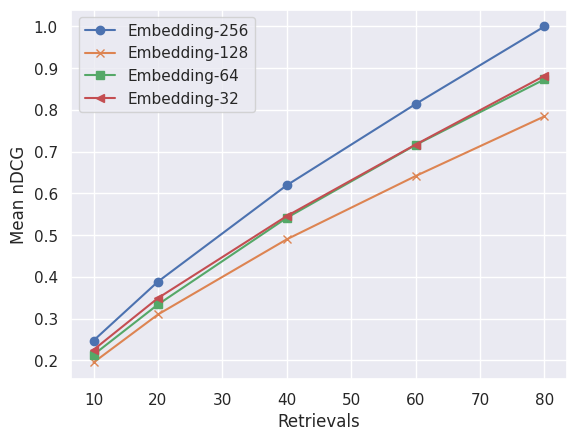

In [ ]:
plt.plot([10, 20, 40, 60, 80], np.array(ndcg_256)/max_val, marker='o', label="Embedding-256")
plt.plot([10, 20, 40, 60, 80], np.array(ndcg_128)/max_val, marker='x', label="Embedding-128")
plt.plot([10, 20, 40, 60, 80], np.array(ndcg_64)/max_val, marker='s', label="Embedding-64")
plt.plot([10, 20, 40, 60, 80], np.array(ndcg_32)/max_val, marker='<', label="Embedding-32")
plt.xlabel("Retrievals")
plt.ylabel("Mean nDCG")
plt.legend()
plt.show()

According to the plot, it can be seen that the best general performance between the four models corresponds to the one with and embedding of dimension 256, getting a mean nDCG of 1.0 at 80 retrievals and a general better performance within the four model since the very beginning (10 retrievals).
Hence, the model with 256 embedding size is chosen as the best one and explored a little more visually in the next section.

## 3. Embedding visualization

In [ ]:
import plotly.express as px
from sklearn.manifold import TSNE

In [ ]:
movies, _ = get_examples()

In [ ]:
embedds = movies.loc[:][["image", "file_name"]]
embedds["embedding"] = [embedding_256(x[np.newaxis, ...]).numpy()[0].reshape(256,) for x in embedds["image"]]
embedds

In order to plot the embedding, a dimensionality reduction technique needs to be applied. In this case, the technique chosen corresponds to T-SNE (t-distributed Stochastic Neighbor Embedding) and a number of components set to 3. This allows a 3D plotting of the embedding.

Note: Since the plots are 3D, opening the notebook in specific IDEs will cause them to not show correctly. In Google Colab it shows fine.

In [ ]:
# T-SNE transformation of the embedding
tsne = TSNE(n_components=3, random_state=42)
test_tsne = tsne.fit_transform(np.array(embedds["embedding"].to_list()))

In the following cells, the reduced embedding is shown for different combination of genres

In [ ]:
indexes = np.where([all(sublist=="drama" or "western" in sublist for sublist in sublist_arr) for sublist_arr in files])[0]
fig = px.scatter_3d(x=test_tsne[indexes, 0], y=test_tsne[indexes, 1], z=test_tsne[indexes, 2], color=np.array(list(map(lambda x: str(x), files[indexes]))))
fig.update_layout(
    title="t-SNE visualization for drama and western",
    xaxis_title="First t-SNE",
    yaxis_title="Second t-SNE",
)
fig.show()

In this case, when comparing western movies with the drama ones, the difference between these two "groups" can be seen. The blue ones corresponding to the western movies and the red ones to the drama movies. Also, there is something interesting when the two genres appear at the same time, they get a closer position to the drama movies while one could expect a position more in the center of the two groups. However, from a general view, the separation between these two genres work as expected.

In [ ]:
indexes = np.where([all(sublist=="horror" or sublist=="comedy" for sublist in sublist_arr) for sublist_arr in files])[0]
fig = px.scatter_3d(x=test_tsne[indexes, 0], y=test_tsne[indexes, 1], z=test_tsne[indexes, 2], color=np.array(list(map(lambda x: str(x), files[indexes]))))
fig.update_layout(
    title="t-SNE visualization for horror and comedy",
    xaxis_title="First t-SNE",
    yaxis_title="Second t-SNE",
)
fig.show()

Now, another two genres that might seem quite different between them, in this case horror (blue) and comedy (red), the embedding visualization shows a separation not as clear as the previous one since some horror points get closer to the comedy points than to the blue point, however, some distinction can be seen between the two. And, for the green points (the two genres happen at the same time), once again they get close the biggest amount of points, in this case, the comedy ones.

In [ ]:
indexes = np.where([all("documentary" in sublist or "drama" in sublist for sublist in sublist_arr) for sublist_arr in files])[0]
fig = px.scatter_3d(x=test_tsne[indexes, 0], y=test_tsne[indexes, 1], z=test_tsne[indexes, 2], color=np.array(list(map(lambda x: str(x), files[indexes]))))
fig.update_layout(
    title="t-SNE visualization for drama and documentary",
    xaxis_title="First t-SNE",
    yaxis_title="Second t-SNE",
)
fig.show()

This last plot, shows the embedding between two genres that might blend a little bit, like documentary and drama. Most of the points are close to each other (red and blue one). But also, some other points far away from the big region of both genres.